# Exploration des données : 

In [94]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import pickle

In [35]:
df = pickle.load(open('df_final.p','rb'))

## Pré traitement des données :

In [36]:
df.reset_index(inplace=True)
df['id'] = df.index
list_columns = ['id' ]+ list(df.columns[:-1])
df = df[list_columns].reset_index()

In [84]:
df_functions = df[['id','functions']]
df_functions['functions'] = df_functions.apply(lambda r: r['functions'].split(sep=','),axis=1)
df_functions =df_functions.explode('functions').reset_index(drop=True)

C:\Users\axelp\AppData\Local\Temp\ipykernel_9908\1132624101.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_functions['functions'] = df_functions.apply(lambda r: r['functions'].split(sep=','),axis=1)


In [70]:
## compute the data set with basic information about the entities
columns_kept = [col for col in list(df.columns) if col not in ['objectives','offers','activities','member_statuses','hash','url_suffix','functions']]
df_information = df[columns_kept]
df_information = df_information.join(pd.json_normalize( df_information['communication'])).drop('communication', axis=1)
df_information = df_information.join(pd.json_normalize( df_information['contact'])).drop('contact', axis=1)

In [ ]:
df_information

,index,id,file_name,name,status,localisation,functions,url_suffix,description,url,website_type,association_name,member_statuses,contact,text_name,facebook_follower,facebook_likes,instagram_followers,instagram_publication
0,0,0,Les_Éphémères,Les Éphémères,Association,Mers-les-Bains,"Prod live : Festival, Prod live : Organisateur",ctct-info.php?s=938,"Depuis 2017, Les Éphémères ont rassemblé des c...",https://lesephemeres.org/,Site personnel,Les Éphémères,"[{'description': 'Membre actif', 'price': None...",{'email': 'contact@lesephemeres.fr'},Les_Éphémères,NaN,NaN,NaN,NaN
1,1,1,Make_My_Day,Make My Day,Association,Amiens,"Collectif d'artistes, Prod live : Organisateur...",ctct-info.php?s=937,"Soutenir, promouvoir et développer les musique...",mailto:assomakemyday@gmail.com,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,2,Le_Bureau_des_Spectacles,Le Bureau des Spectacles,SAS,Lille,Prod live : Organisateur,ctct-info.php?s=936,"Le Bureau des Spectacle imagine, organise et p...",https://www.lebureaudesspectacles.fr,Site personnel,Le Bureau des Spectacles,"[{'description': 'Membre actif', 'price': None...",{'email': 'billetterie@lebureaudesspectacles.fr'},Le_Bureau_des_Spectacles,NaN,NaN,NaN,NaN
3,3,3,Billy_Society_Production,Billy Society Production,,Lille,Prod live : Organisateur,ctct-info.php?s=932,Billy Society Production s'inscrit dans la lig...,https://www.facebook.com/billysociety.prod,Facebook,Billy Society Production,"[{'description': 'Membre actif', 'price': None...",{'email': 'billysocietyprod@gmail.com'},Billy_Society_Production,95.0,76.0,NaN,NaN
4,4,4,Ginger_Kick_Events,Ginger Kick Events,Association,La Madeleine,Prod live : Organisateur,ctct-info.php?s=926,"Organisation de concerts rock, principalement ...",https://linktr.ee/gingerkick,Site personnel,Ginger Kick Events,"[{'description': 'Membre actif', 'price': 20, ...",{'email': 'contact@gingerkickevents.com'},Ginger_Kick_Events,150.0,100.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
164,164,164,Rock_Aisne_festival,Rock Aisne festival,Association,Villequier-Aumont,"Prod live : Organisateur, Prod live : Festival",ctct-info.php?s=155,Le festival se déroule au CENTRE CULTUREL DE C...,https://www.rockaisne.com,Site personnel,Rock Aisne Festival,"[{'description': 'VIP', 'price': 70, 'status':...",{'email': 'jeanmichelfondement@gmail.com'},Rock_Aisne_festival,1000.0,2500.0,NaN,15.0
165,165,165,Reivax_Tour,Reivax Tour,Association,La Fère,"Prod live : Organisateur, Prod live : Tour et ...",ctct-info.php?s=566,Reivax Tour (écrit aussi Reivaks Tour) est une...,https://reivaxtour.mystrikingly.com,Site personnel,Association des Amis de la Nature,[{'description': 'Membre actif participant rég...,{'email': 'contact@amisnature.com'},Reivax_Tour,1500.0,2000.0,1200.0,NaN
166,166,166,Saint-Omer_Jaaz_festival,Saint-Omer Jaaz festival,EPCC,Saint-Omer,"Prod live : Organisateur, Prod live : Festival...",ctct-info.php?s=182,Fort de 25 concerts gratuits présentés dans de...,http://www.saintomerjaazfestival.fr,Site personnel,Association Jaaz Festival,"[{'description': 'Membre actif', 'price': None...",{'email': 'contact@jaazfestival.fr'},Saint-Omer_Jaaz_festival,1500.0,1200.0,800.0,50.0
167,167,167,Rock_en_Stock,Rock en Stock,Association,Etaples sur Mer,"Prod live : Organisateur, Prod live : Festival",ctct-info.php?s=184,,https://www.rockenstock.fr,Site personnel,Association Rock en Stock Opale,"[{'description': 'Membre actif', 'price': None...",{'email': 'contact@rockenstock.fr'},Rock_en_Stock,NaN,NaN,NaN,NaN


In [161]:
i=101
print(df.loc[i,'association_name'])
print(df.loc[i,'offers'])
print(df.loc[i,'activities'])
print(df.loc[i,'objectives'])

Association des Amis de la Nature
[{'description': 'Réduction sur les ateliers de cuisine pour les membres actifs', 'name': 'Réduction Atelier Cuisine', 'price': 20, 'target_group': 'Membres actifs'}, {'description': 'Sortie randonnée gratuite pour les nouveaux membres', 'name': 'Randonnée Gratuite', 'price': None, 'target_group': 'Nouveaux membres'}]
[{'name': 'Atelier de cuisine', 'price': 25}, {'name': 'Sortie randonnée', 'price': None}]
["Promouvoir la protection de l'environnement", 'Organiser des activités de plein air', "Sensibiliser le public à l'écologie"]


In [162]:
df.columns ##.drop_columns(['objectives, activities','offers','member_statuses'])

Index(['index', 'id', 'file_name', 'name', 'status', 'localisation',
       'functions', 'url_suffix', 'description', 'url', 'website_type',
       'association_name', 'objectives', 'activities', 'offers',
       'member_statuses', 'contact', 'communication', 'hash', 'text_name'],
      dtype='object')

In [88]:
## Create dataframe for objectives,activities, functions, offers, member_statuses
##-------------------------------------------------------------------------------


df_objectives = df[['id','objectives']].explode('objectives')
df_activities = df[['id','activities']].explode('activities')
df_offers = df[['id','offers']].explode('offers')
df_members = df[['id','member_statuses']].explode('member_statuses')

df_offers = df_offers.join(pd.json_normalize(df_offers['offers'] , sep = '_')).drop('offers',axis=1)
df_activities = df_activities.join( pd.json_normalize(df_activities['activities']) ).drop('activities',axis=1)
df_members = df_members.join( pd.json_normalize(df_members['member_statuses']) ).drop('member_statuses',axis=1)

## Create the functions dataframe.
df_functions = df[['id','functions']]
df_functions['functions'] = df_functions.apply(lambda r: r['functions'].split(sep=','),axis=1)
df_functions =df_functions.explode('functions').reset_index(drop=True)


C:\Users\axelp\AppData\Local\Temp\ipykernel_9908\1078076753.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_functions['functions'] = df_functions.apply(lambda r: r['functions'].split(sep=','),axis=1)


In [95]:
import pickle
folder_name = 'data/'
os.makedirs(folder_name)
pickle.dump(df_objectives,open(folder_name+'df_objectives.p','wb'))
pickle.dump(df_activities,open(folder_name+'df_activities.p','wb'))
pickle.dump(df_offers,open(folder_name+'df_offers.p','wb'))
pickle.dump(df_members,open(folder_name+'df_members.p','wb'))
pickle.dump(df_information,open(folder_name+'df_information.p','wb'))
pickle.dump(df_functions,open(folder_name+'df_functions.p','wb'))

## Exploration de df_information

In [ ]:
import pickle
folder_name = 'data/'
df_objectives = pickle.load(open(folder_name+'df_objectives.p','rb'))
df_offers = pickle.load(open(folder_name+'df_offers.p','rb'))
df_members = pickle.load(open(folder_name+'df_members.p','rb'))
df_information = pickle.load(open(folder_name+'df_information.p','rb'))
df_functions = pickle.load(open(folder_name+'df_functions.p','rb'))


,index,id,file_name,name,status,localisation,description,url,website_type,association_name,text_name,facebook_follower,facebook_likes,instagram_followers,instagram_publication,email
0,0,0,Les_Éphémères,Les Éphémères,Association,Mers-les-Bains,"Depuis 2017, Les Éphémères ont rassemblé des c...",https://lesephemeres.org/,Site personnel,Les Éphémères,Les_Éphémères,NaN,NaN,NaN,NaN,contact@lesephemeres.fr
1,1,1,Make_My_Day,Make My Day,Association,Amiens,"Soutenir, promouvoir et développer les musique...",mailto:assomakemyday@gmail.com,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,2,Le_Bureau_des_Spectacles,Le Bureau des Spectacles,SAS,Lille,"Le Bureau des Spectacle imagine, organise et p...",https://www.lebureaudesspectacles.fr,Site personnel,Le Bureau des Spectacles,Le_Bureau_des_Spectacles,NaN,NaN,NaN,NaN,billetterie@lebureaudesspectacles.fr
3,3,3,Billy_Society_Production,Billy Society Production,,Lille,Billy Society Production s'inscrit dans la lig...,https://www.facebook.com/billysociety.prod,Facebook,Billy Society Production,Billy_Society_Production,95.0,76.0,NaN,NaN,billysocietyprod@gmail.com
4,4,4,Ginger_Kick_Events,Ginger Kick Events,Association,La Madeleine,"Organisation de concerts rock, principalement ...",https://linktr.ee/gingerkick,Site personnel,Ginger Kick Events,Ginger_Kick_Events,150.0,100.0,NaN,NaN,contact@gingerkickevents.com



Informations générales :
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 169 entries, 0 to 168
Data columns (total 16 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   index                  169 non-null    int64  
 1   id                     169 non-null    int64  
 2   file_name              169 non-null    object 
 3   name                   169 non-null    object 
 4   status                 169 non-null    object 
 5   localisation           169 non-null    object 
 6   description            169 non-null    object 
 7   url                    165 non-null    object 
 8   website_type           158 non-null    object 
 9   association_name       135 non-null    object 
 10  text_name              135 non-null    object 
 11  facebook_follower      87 non-null     float64
 12  facebook_likes         81 non-null     float64
 13  instagram_followers    25 non-null     float64
 14  instagram_publication  20 non-nu

,index,id,facebook_follower,facebook_likes,instagram_followers,instagram_publication
count,169.000000,169.000000,87.000000,81.000000,25.000000,20.000000
mean,84.000000,84.000000,1636.321839,1748.802469,1066.440000,146.350000
std,48.930222,48.930222,1781.629242,1880.509874,525.175533,159.275093
min,0.000000,0.000000,58.000000,48.000000,120.000000,12.000000
25%,42.000000,42.000000,488.500000,406.000000,800.000000,50.000000
50%,84.000000,84.000000,1400.000000,1200.000000,1200.000000,50.000000
75%,126.000000,126.000000,1700.000000,2000.000000,1200.000000,225.000000
max,168.000000,168.000000,10000.000000,10000.000000,3000.000000,500.000000



Valeurs manquantes :


index                      0
id                         0
file_name                  0
name                       0
status                     0
localisation               0
description                0
url                        4
website_type              11
association_name          34
text_name                 34
facebook_follower         82
facebook_likes            88
instagram_followers      144
instagram_publication    149
email                     34
dtype: int64

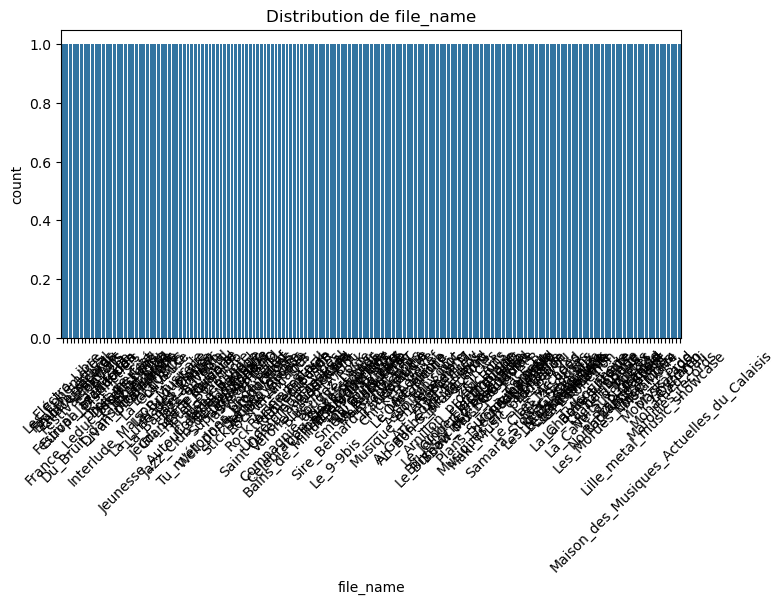

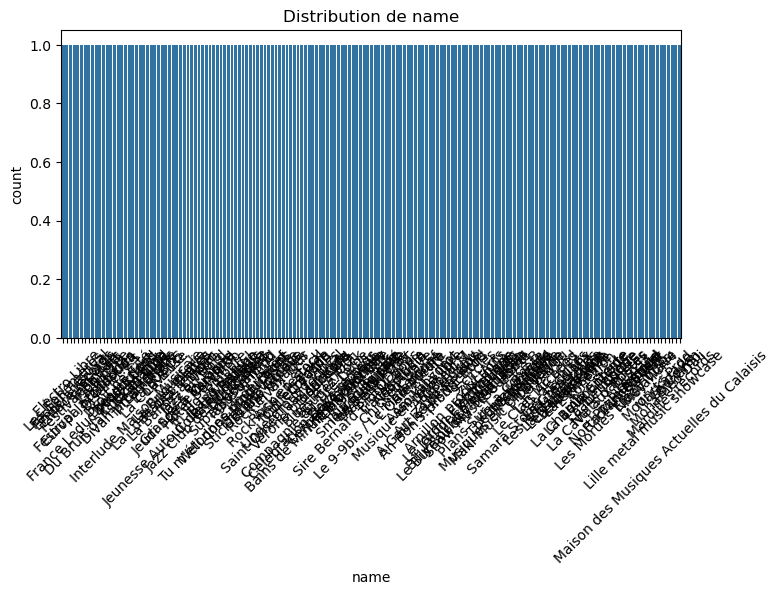

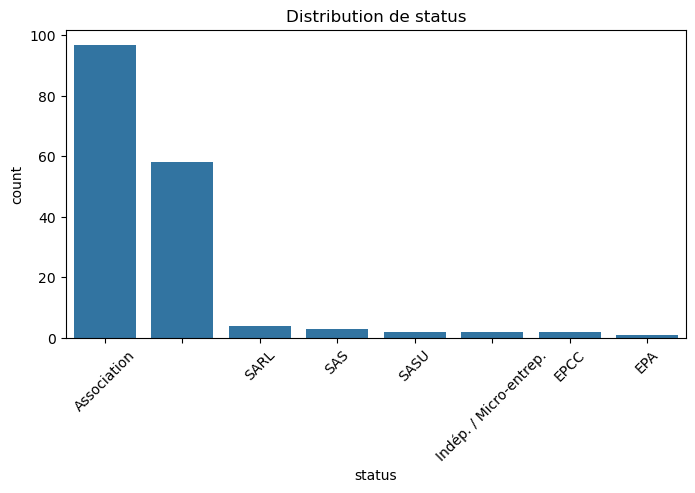

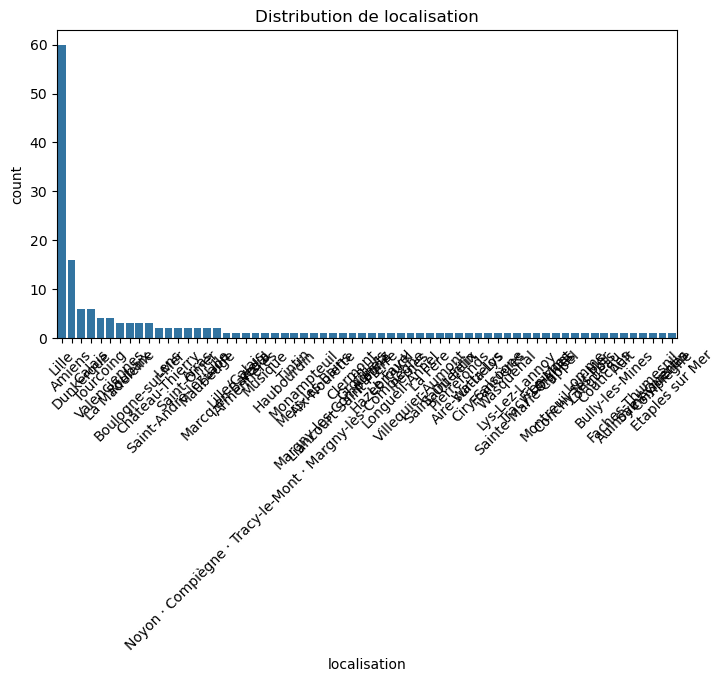

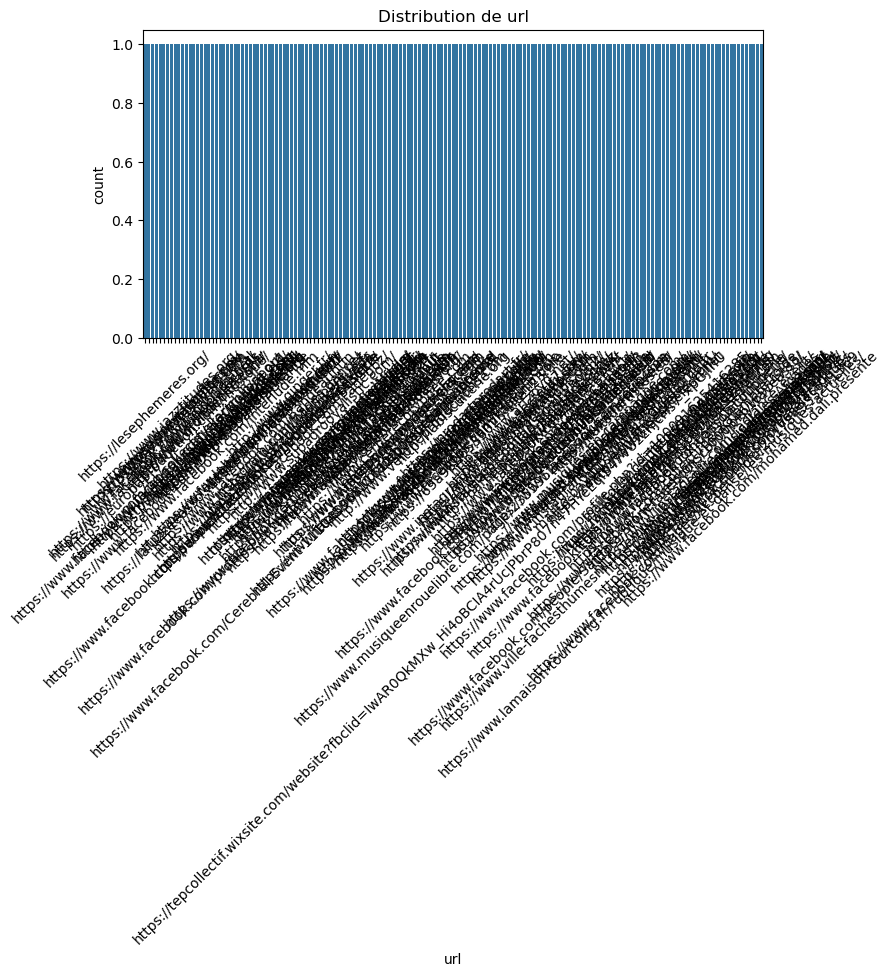

...

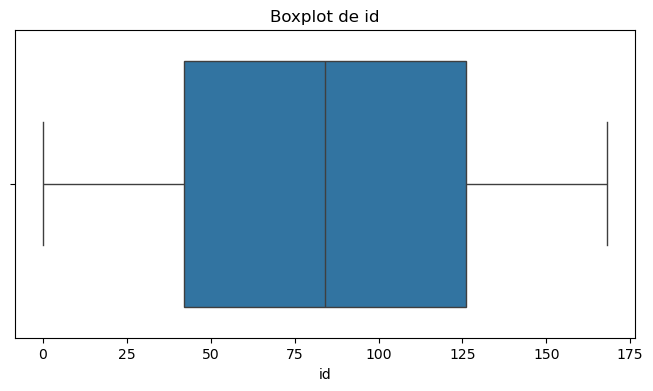

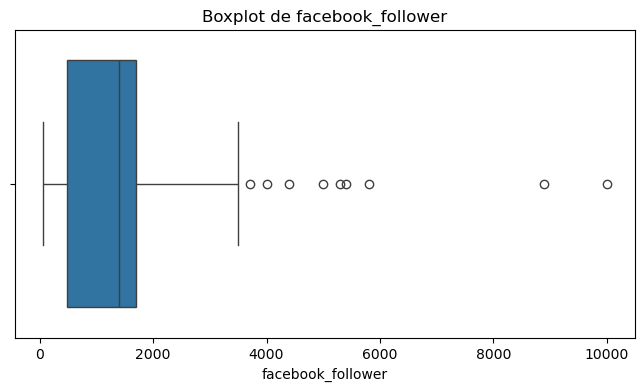

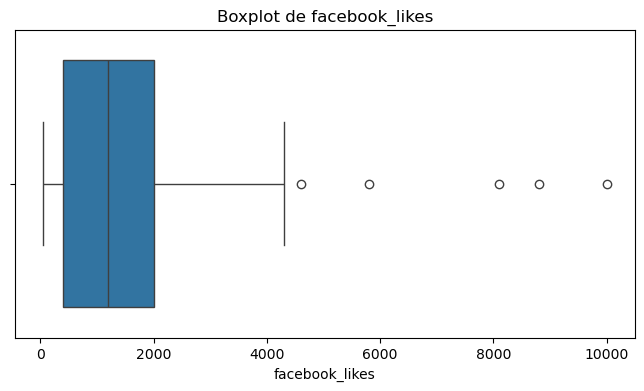

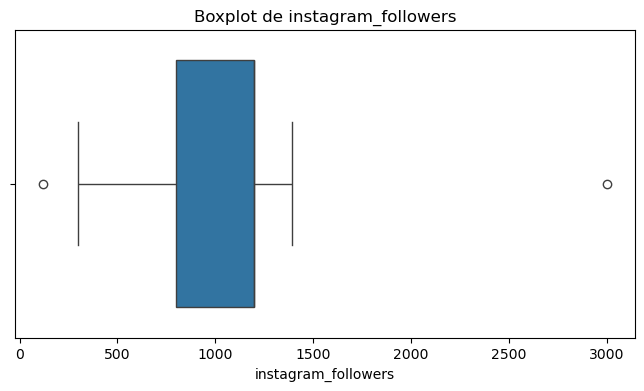

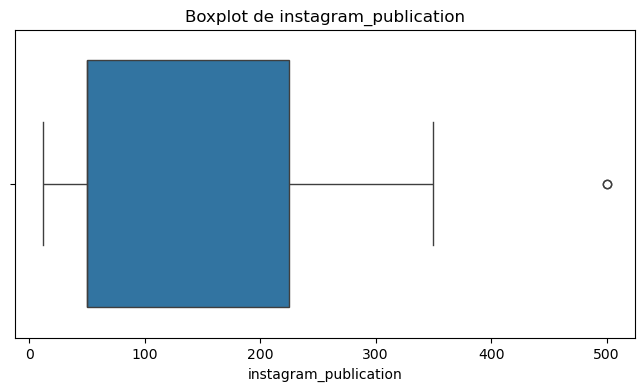

In [ ]:
# Aperçu des données
display(df_information.head())
print("\nInformations générales :")
df_information.info()
print("\nStatistiques descriptives :")
display(df_information.describe())

# Vérification des valeurs manquantes
print("\nValeurs manquantes :")
display( df_information.isnull().sum() )

# Analyse des variables catégorielles
cat_cols = df_information.select_dtypes(include=['object']).columns
for col in cat_cols:
    plt.figure(figsize=(8, 4))
    sns.countplot(x=df_information[col], order=df_information[col].value_counts().index)
    plt.xticks(rotation=45)
    plt.title(f"Distribution de {col}")
    plt.show()

    # Analyse des relations entre variables (corrélation pour les numériques)
plt.figure(figsize=(10, 6))
sns.heatmap(df_information[['facebook_follower'	,'facebook_likes'	,'instagram_followers'	,'instagram_publication']].corr(), annot=True, cmap='coolwarm', fmt='.2f')
plt.title("Matrice de Corrélation")
plt.show()

# Détection des valeurs aberrantes
num_cols = df_information.select_dtypes(include=['number']).columns
for col in num_cols:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df_information[col])
    plt.title(f"Boxplot de {col}")
    plt.show()

In [ ]:
i=35
print(df.loc[i,'association_name'])
print( df.loc[i,'offers'])
print(df.loc[i,'activities'])
print(df.loc[i,'objectives'])

Amikal Sonic
[{'description': "Amikal Sonic's saturday Confined Clubbing livestream", 'name': 'Confined Clubbing Livestream', 'price': None, 'target_group': 'Facebook users'}]
[{'name': 'Confined Clubbing Livestream', 'price': None}]
['Chaque semaine durant le COVID19 confinement', 'everyweek during the COVID19 lockdown', 'livre stream on facebook']


In [120]:
df_information[df_information.duplicated(subset=['association_name'])]

,index,id,file_name,name,status,localisation,description,url,website_type,association_name,text_name,facebook_follower,facebook_likes,instagram_followers,instagram_publication,email
10,10,10,Plans_Sur_La_Comète,Plans Sur La Comète,Association,Lille,,https://www.instagram.com/plans.sur.la.comete/,Instagram,NaN,NaN,NaN,NaN,NaN,NaN,NaN
13,13,13,C-Culturel,C-Culturel,,Valenciennes,C – CULTUREL est une association valenciennois...,mailto:c-culturel@hotmail.fr,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN
14,14,14,Maki_Music_production,Maki Music production,Association,Wasquehal,,None,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15,15,15,The_Nest_Record,The Nest Record,,,,https://www.instagram.com/the__nest__record/,Instagram,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16,16,16,Korozik_muzik,Korozik muzik,Indép. / Micro-entrep.,Lys-Lez-Lannoy,Organisation d’évènements culturels.,https://www.instagram.com/korozikmuzik/,Instagram,NaN,NaN,NaN,NaN,NaN,NaN,NaN
20,20,20,Arnillon_productions,Arnillon productions,Association,Lille,,None,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN
21,21,21,S.H.I.N.E_Prod,S.H.I.N.E Prod,Association,Amiens,Structure spécialisée dans la production événe...,https://www.instagram.com/shine.prod/,Instagram,NaN,NaN,NaN,NaN,NaN,NaN,NaN
27,27,27,Chicken_Wave,Chicken Wave,Association,Lille,Créateur d'évènements (bass music) house sur L...,https://www.instagram.com/chickenwaveparty/,Instagram,NaN,NaN,NaN,NaN,NaN,NaN,NaN
33,33,33,Ad_Aurora,Ad Aurora,Association,Amiens,Ad Aurora c'est :- Un espoir de rendre la fête...,https://www.instagram.com/ad.aurora.event/,Instagram,NaN,NaN,NaN,NaN,NaN,NaN,NaN
40,40,40,Secteur_7,Secteur 7,Association,Maubeuge,L'action de l'Association Secteur 7 est basée ...,http://www.secteur7.eu/,Site personnel,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [135]:
df.loc[18]

index                                                              18
id                                                                 18
file_name                                                      Face_B
name                                                           Face B
status                                                               
localisation                                                    Lille
functions              Collectif d'artistes, Prod live : Organisateur
url_suffix                                        ctct-info.php?s=910
description                                                          
url                                          https://linktr.ee/face.b
website_type                                           Site personnel
association_name                                 Association Sportive
objectives          [Promouvoir le sport, Organiser des événements...
activities          [{'name': 'Randonnée', 'price': 10}, {'name': ...
offers              

In [ ]:
print(df[df['association_name']== 'Association Sportive'].loc[18,'offers'])
print(df[df['association_name']== 'Association Sportive'].loc[142,'objectives'])

[{'description': 'Abonnement annuel', 'name': 'Abonnement', 'price': 100, 'target_group': 'Tous les membres'}, {'description': 'Cours de tennis', 'name': 'Cours de tennis', 'price': 50, 'target_group': 'Membres intéressés par le tennis'}, {'description': 'Sortie randonnée', 'name': 'Sortie randonnée', 'price': None, 'target_group': 'Tous les membres'}]
['Promouvoir le sport', 'Organiser des événements sportifs', 'Encourager une vie saine']


In [137]:
df_information.describe()

,index,id,facebook_follower,facebook_likes,instagram_followers,instagram_publication
count,169.000000,169.000000,87.000000,81.000000,25.000000,20.000000
mean,84.000000,84.000000,1636.321839,1748.802469,1066.440000,146.350000
std,48.930222,48.930222,1781.629242,1880.509874,525.175533,159.275093
min,0.000000,0.000000,58.000000,48.000000,120.000000,12.000000
25%,42.000000,42.000000,488.500000,406.000000,800.000000,50.000000
50%,84.000000,84.000000,1400.000000,1200.000000,1200.000000,50.000000
75%,126.000000,126.000000,1700.000000,2000.000000,1200.000000,225.000000
max,168.000000,168.000000,10000.000000,10000.000000,3000.000000,500.000000


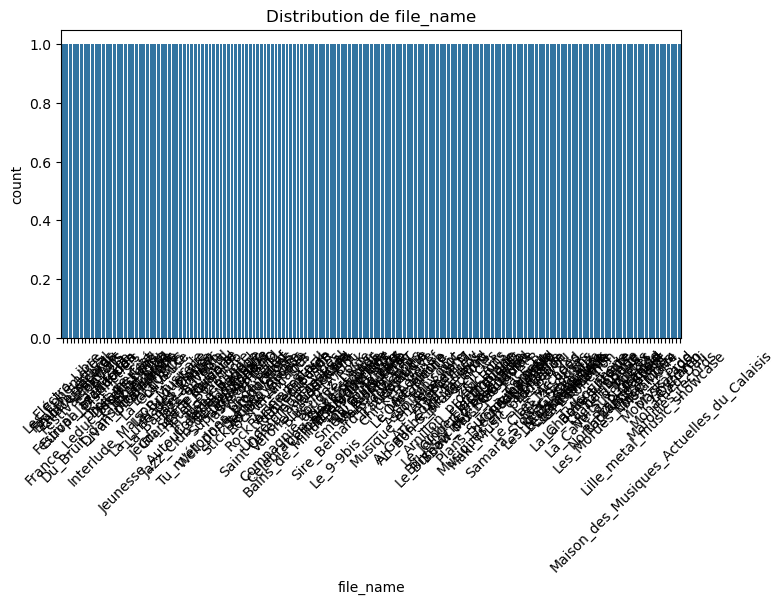

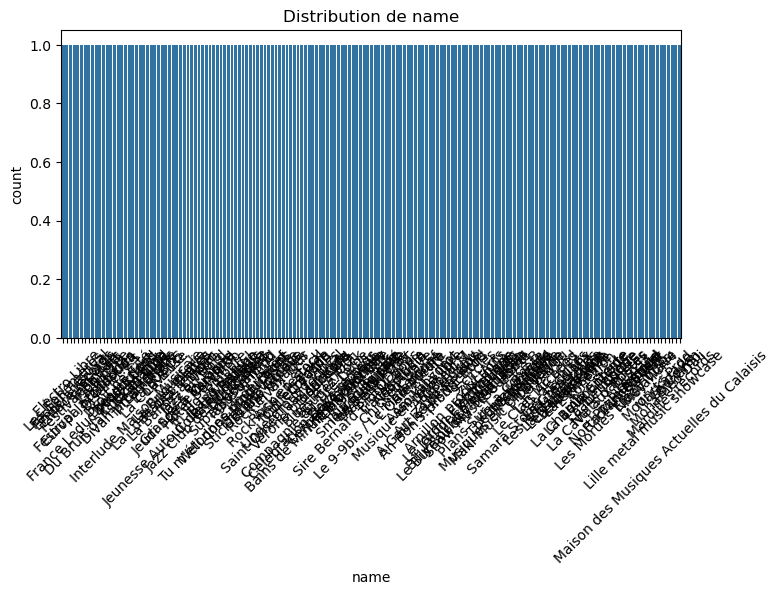

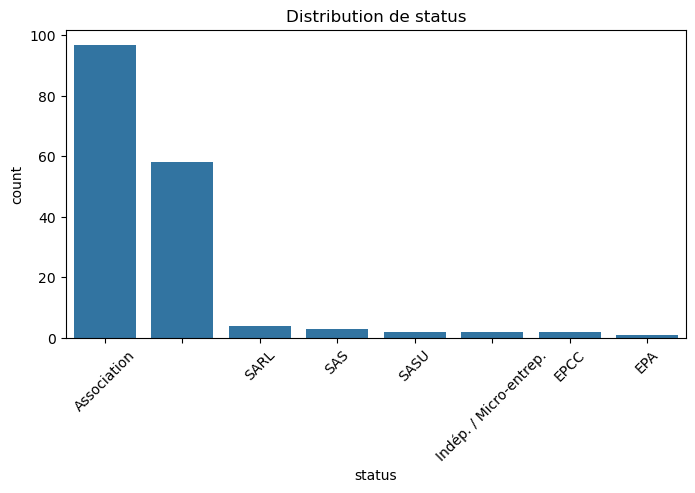

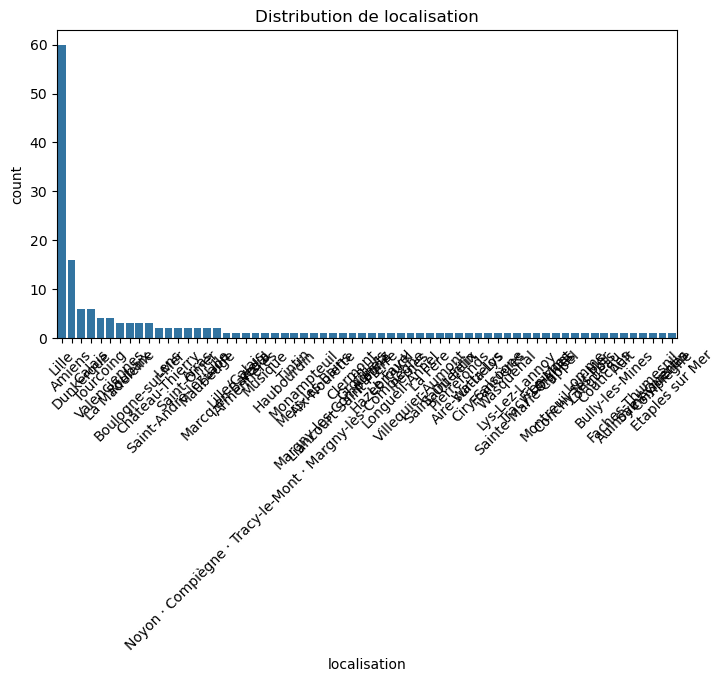

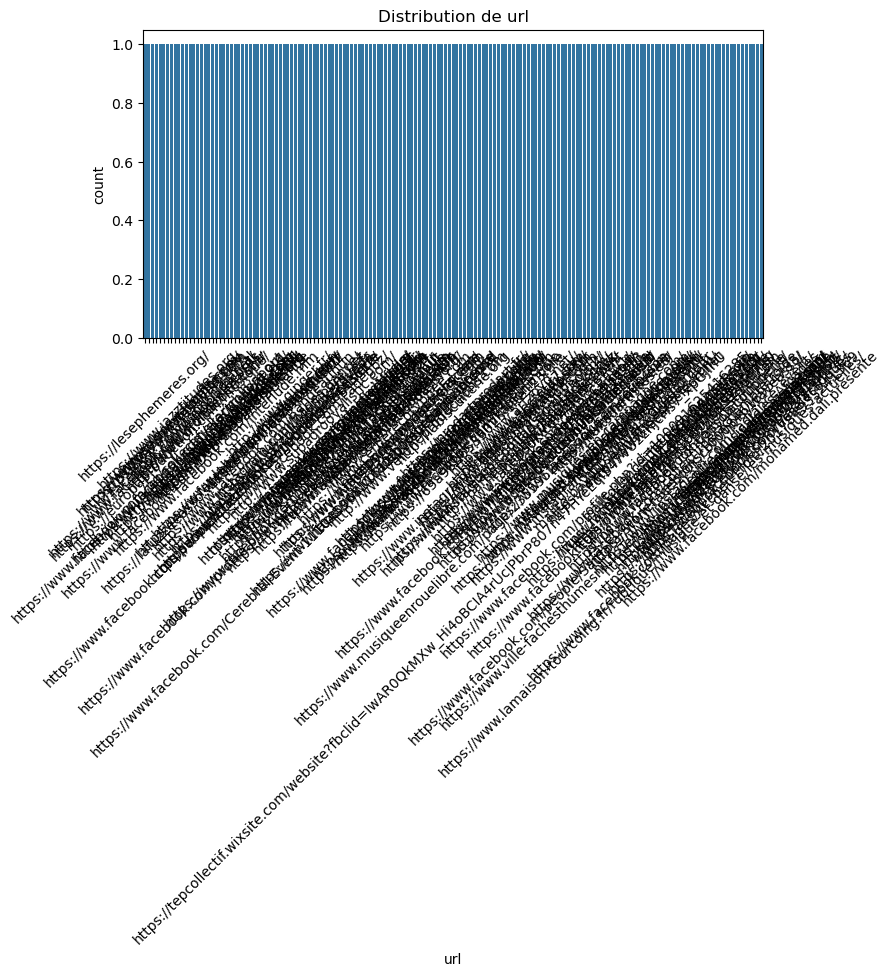

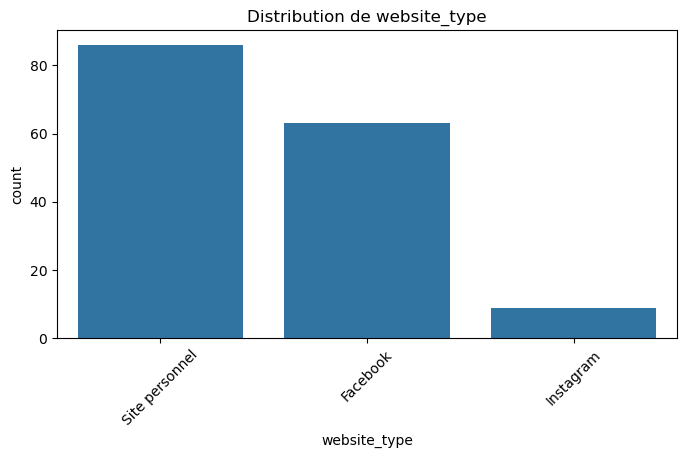

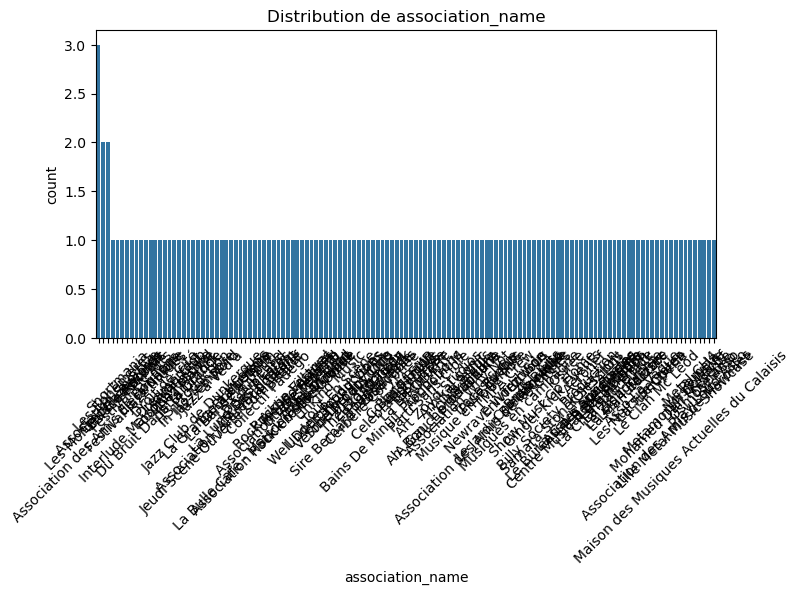

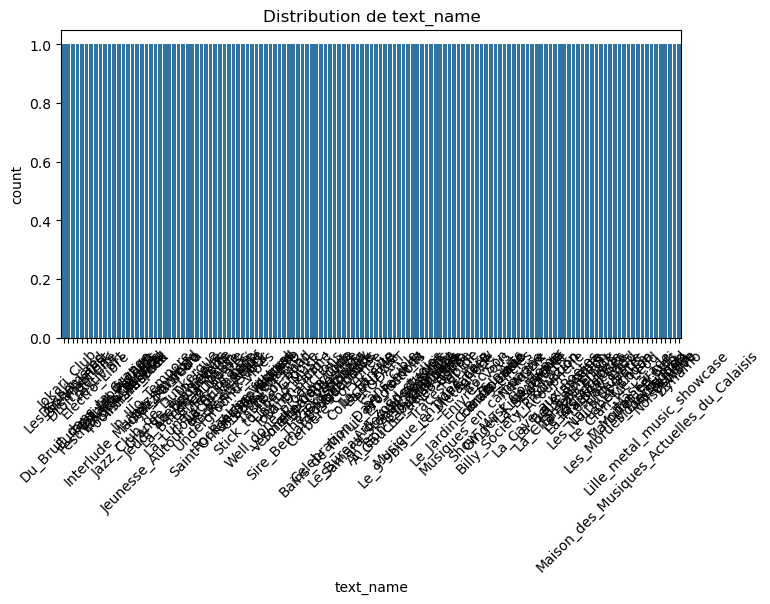

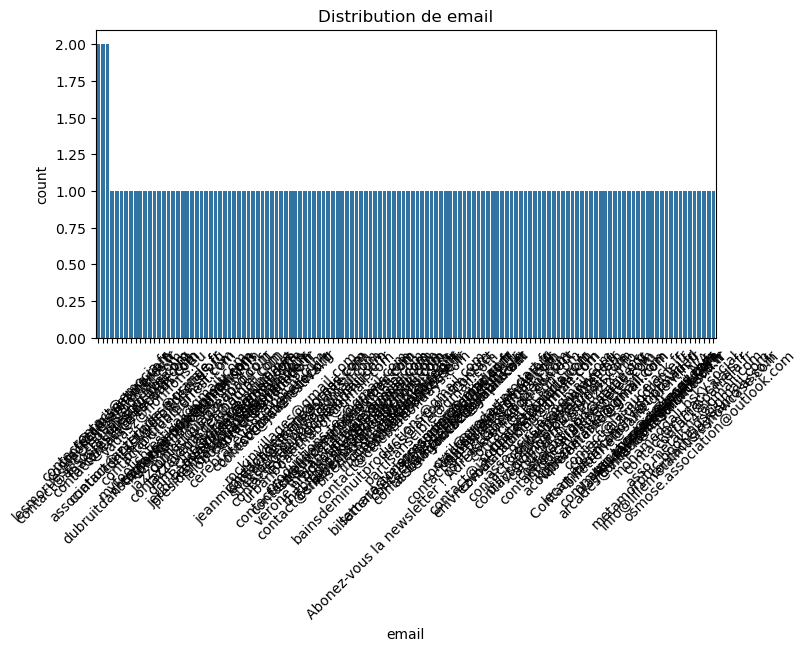

In [143]:
# Analyse des variables catégorielles
cat_cols = df_information.select_dtypes(include=['object']).columns
for col in cat_cols:
    plt.figure(figsize=(8, 4))
    sns.countplot(x=df_information[col], order=df_information[col].value_counts().index)
    plt.xticks(rotation=45)
    plt.title(f"Distribution de {col}")
    plt.show()


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Chargement des données
# Remplacez 'dataset.csv' par le nom de votre fichier
df = pd.read_csv('dataset.csv')

# Aperçu des données
display(df.head())
print("\nInformations générales :")
df.info()
print("\nStatistiques descriptives :")
display(df.describe())

# Vérification des valeurs manquantes
print("\nValeurs manquantes :")
display(df.isnull().sum())

# Vérification des doublons
print("\nDoublons :", df.duplicated().sum())

# Distribution des variables numériques
plt.figure(figsize=(12, 6))
df.hist(bins=30, figsize=(12, 10), layout=(5, 3))
plt.show()

# Analyse des variables catégorielles
cat_cols = df.select_dtypes(include=['object']).columns
for col in cat_cols:
    plt.figure(figsize=(8, 4))
    sns.countplot(x=df[col], order=df[col].value_counts().index)
    plt.xticks(rotation=45)
    plt.title(f"Distribution de {col}")
    plt.show()

# Analyse des relations entre variables (corrélation pour les numériques)
plt.figure(figsize=(10, 6))
sns.heatmap(df.corr(), annot=True, cmap='coolwarm', fmt='.2f')
plt.title("Matrice de Corrélation")
plt.show()

# Détection des valeurs aberrantes
num_cols = df.select_dtypes(include=['number']).columns
for col in num_cols:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df[col])
    plt.title(f"Boxplot de {col}")
    plt.show()

# Sauvegarde du dataset nettoyé (après modifications éventuelles)
df.to_csv('cleaned_data.csv', index=False)
print("\nDataset nettoyé sauvegardé sous 'cleaned_data.csv'")

## Explore df_offers :

In [105]:
i=35
print(df.loc[i,'association_name'])
print( df.loc[i,'offers'])
print(df.loc[i,'activities'])
print(df.loc[i,'objectives'])

Amikal Sonic
[{'description': "Amikal Sonic's saturday Confined Clubbing livestream", 'name': 'Confined Clubbing Livestream', 'price': None, 'target_group': 'Facebook users'}]
[{'name': 'Confined Clubbing Livestream', 'price': None}]
['Chaque semaine durant le COVID19 confinement', 'everyweek during the COVID19 lockdown', 'livre stream on facebook']


## Explore df_activities

## Explore df_members

## Explore df_objectives